# Data processing

Data source:

In [27]:
import numpy as np
import pandas as pd
import scanpy as sc

In [11]:
sc.set_figure_params(dpi=300, frameon=False)
sc.logging.print_header()

scanpy==1.6.0 anndata==0.7.4 umap==0.4.6 numpy==1.19.1 scipy==1.5.2 pandas==1.1.1 scikit-learn==0.23.2 statsmodels==0.11.1


This took way too long to read in...

In [ ]:
%%time
adata = sc.read_h5ad('/storage/groups/ml01/workspace/meshal.ansari/Covid19_ALI_MULTIseq/201207_covid19_ALI_assigned.h5ad')
adata

In [8]:
adata

AnnData object with n_obs × n_vars = 221974 × 18115
    obs: 'identifier', 'barcode_round', 'name', 'patient', 'n_counts', 'n_genes', 'percent_mito', 'viral_counts', 'percent_viral', 'S_score', 'G2M_score', 'phase', 'deMULTIplex_calls', 'final_calls', 'dbscan', 'treatment_virus', 'treatment', 'infected', 'infected_10'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'identifier_colors', 'infected_10_colors', 'infected_colors', 'neighbors', 'patient_colors', 'pca', 'treatment_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

### Examine markers

TODO: determine how much factors like `n_counts`, `n_genes`, `percent_mito` etc. might be a result of batch.

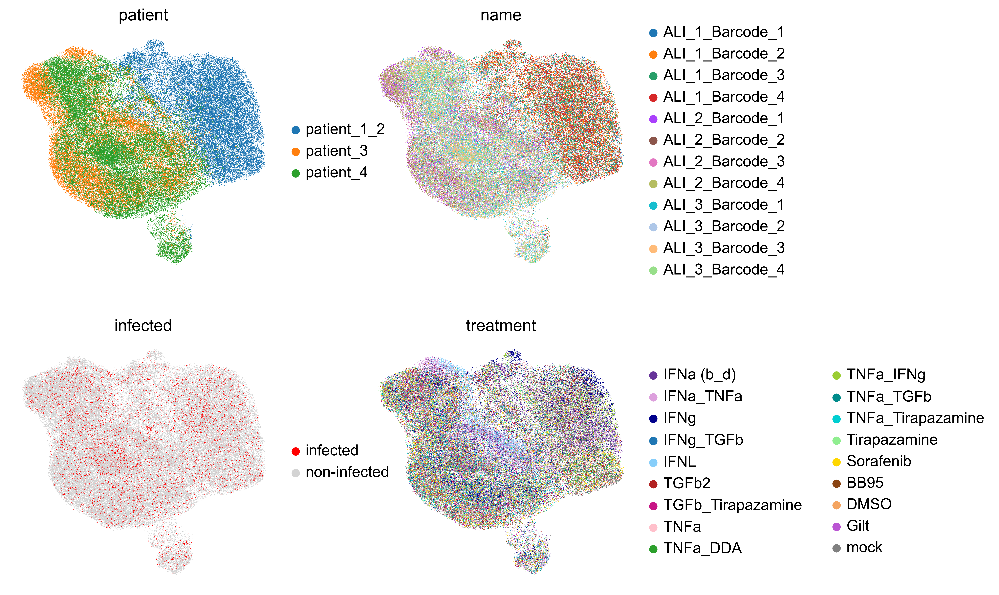

In [16]:
sc.pl.umap(adata, color=['patient', 'name', 'infected', 'treatment'], ncols=2)

#### Examine infections

In [32]:
print(24033/197941)
adata.obs['infected'].value_counts()

0.12141496708615193


non-infected    197941
infected         24033
Name: infected, dtype: int64

In [23]:
adata.obs['log1p(viral_counts)'] = np.log1p(adata.obs['viral_counts'])

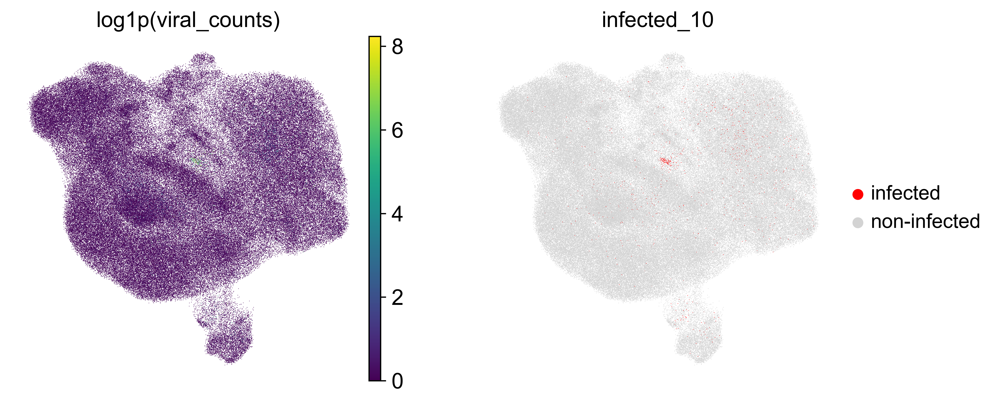

In [26]:
sc.pl.umap(adata, color=['log1p(viral_counts)', 'infected_10'])

In [55]:
df = pd.crosstab(adata.obs['patient'].values, adata.obs['infected'].values)
df.columns = df.columns.to_list()  # pd.crosstab returns CategoricalIndex instead of Index
df['ratio'] = df['infected']/df['non-infected']
df.sort_values('ratio')

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,infected,non-infected,ratio
row_0,,,
patient_3,5700,67800,0.084071
patient_1_2,7955,60667,0.131126
patient_4,10378,69474,0.149380


In [48]:
df = pd.crosstab(adata.obs['treatment'].values, adata.obs['infected'].values)
df.columns = df.columns.to_list()  # pd.crosstab returns CategoricalIndex instead of Index
df['ratio'] = df['infected']/df['non-infected']
df.sort_values('ratio')

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,infected,non-infected,ratio
row_0,,,
IFNg_TGFb,865,7829,0.110487
IFNa_TNFa,1486,13400,0.110896
TGFb_Tirapazamine,870,7743,0.112360
IFNg,1867,16487,0.113241
TNFa_Tirapazamine,862,7595,0.113496
IFNL,974,8382,0.116201
IFNa (b_d),1941,16563,0.117189
TNFa_TGFb,1259,10544,0.119404
TGFb2,1958,16121,0.121456


Also needs contextualization with viral load.. 

#### Examine perturbations

In [51]:
pd.crosstab(adata.obs['treatment'].values, adata.obs['patient'].values)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


col_0,patient_1_2,patient_3,patient_4
row_0,,,
IFNa (b_d),9724,4020,4760
IFNa_TNFa,3800,6526,4560
IFNg,7798,5787,4769
IFNg_TGFb,0,4389,4305
IFNL,0,4520,4836
TGFb2,7842,5346,4891
TGFb_Tirapazamine,0,3729,4884
TNFa,7440,5711,4265
TNFa_DDA,4344,0,0


....This is not what I was expecting....